# **Installing the Dependencies**

We are installing transformers package to implement our transformer

In [ ]:
!pip install -q datasets transformers evaluate

We are installing this tensorflow/examples as our dataset is in that examples directory

In [ ]:
!pip install git+https://github.com/tensorflow/examples.git

  Cloning https://github.com/tensorflow/examples.git to /tmp/pip-req-build-diuwqjtc
  Running command git clone --filter=blob:none --quiet https://github.com/tensorflow/examples.git /tmp/pip-req-build-diuwqjtc
  Resolved https://github.com/tensorflow/examples.git to commit fff4bcda7201645a1efaea4534403daf5fc03d42
  Preparing metadata (setup.py) ... done
  Created wheel for tensorflow-examples: filename=tensorflow_examples-0.1703207612.1461250479831370929614362828255168868146460245314-py3-none-any.whl size=301584 sha256=191dc043e01b64dd291a935e3e6495e5a3963caac9243746f0f4d039bc09d46f
  Stored in directory: /tmp/pip-ephem-wheel-cache-ej62gzja/wheels/72/5f/d0/7fe769eaa229bf20101d11a357eb23c83c481bee2d7f710599
Successfully built tensorflow-examples


Installing pyspark library

In [ ]:
!pip install pyspark

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 317.0/317.0 MB 2.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyspark: filename=pyspark-3.5.1-py2.py3-none-any.whl size=317488491 sha256=64d44d6368a8399f7d85c937a9909664c527b5f085d20fb2b5f5a284e463a72d
  Stored in directory: /root/.cache/pip/wheels/80/1d/60/2c256ed38dddce2fdd93be545214a63e02fbd8d74fb0b7f3a6
Successfully built pyspark


Some additional features which maybe unstable but we need them hence we are installing

In [ ]:
!pip install tensorflow_addons

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 611.8/611.8 kB 8.6 MB/s eta 0:00:00


# **Importing Libraries**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import tensorflow as tf
import tensorflow_datasets as tfds
from tensorflow_examples.models.pix2pix import pix2pix
from IPython.display import clear_output
import matplotlib.pyplot as plt
from pyspark.sql import SparkSession
import seaborn as sns
from pyspark.sql import SparkSession
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from pyspark.sql import SparkSession
import numpy as np
from pyspark.ml.image import ImageSchema

# **Patchification using Big Data Approach**

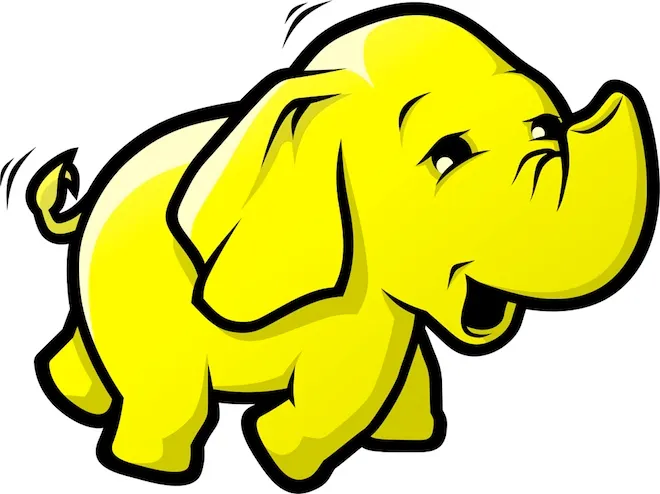

**Motivation:**
* Remote sensing images are often large and high-resolution.
* Processing the entire image at once can be computationally expensive and memory-intensive.
* Patchification allows efficient handling of large images by breaking them down into manageable chunks.



**Patch Extraction:**
* Divide the image into a grid of smaller patches.
* Each patch represents a localized region of the scene.
* The size of the patches depends on the application and available resources.

**Benefits**:
* Parallel Processing: Patches can be processed independently, enabling parallelization.
* Memory Efficiency: Smaller patches fit into memory, avoiding memory limitations.
* Local Context: Each patch captures local context, which is essential for feature extraction and classification.

**Overlap vs. Non-Overlap:**
* Non-Overlapping Patches: Adjacent patches do not overlap. Simple to implement but may miss contextual information at patch boundaries.
* Overlapping Patches: Patches overlap, ensuring smoother transitions between neighboring regions. Provides better context but increases redundancy.

**Applications:**
* Object Detection: Detect objects (e.g., buildings, roads) within individual patches.
* Land Cover Classification: Classify land cover types (e.g., forest, water, urban) in each patch.
* Change Detection: Compare patches from different time points to identify changes.

**Challenges:**
* Boundary Effects: Patches near the image edges may lack context due to missing neighboring pixels.
* Patch Size Selection: Choosing an appropriate patch size is crucial for balancing context and computational efficiency.



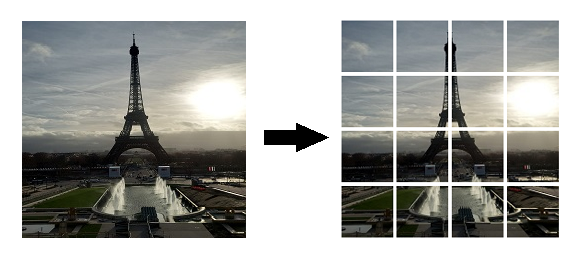

In [ ]:
from pyspark.sql import SparkSession
from PIL import Image
import numpy as np

# Create SparkSession
spark = SparkSession.builder \
    .appName("ImagePatchSplitter") \
    .getOrCreate()

# Load the image
image_path = "/content/drive/MyDrive/wallpaper.jpg"
image_data = Image.open(image_path)

# Convert image data to numpy array
image_array = np.array(image_data)

# Define patch size
patch_width = 100
patch_height = 100

# Parallelize the image data
image_rdd = spark.sparkContext.parallelize([image_array])

# Function to split the image into patches
def split_into_patches(image_data):
    width, height, _ = image_data.shape
    patches = []
    for x in range(0, width, patch_width):
        for y in range(0, height, patch_height):
            patch = image_data[x:x+patch_width, y:y+patch_height, :]
            patches.append((x, y, patch))
    return patches

# Apply patch splitting function to each partition
patch_rdd = image_rdd.flatMap(split_into_patches)

# Collect the patches
patches = patch_rdd.collect()

# Output patch information
for i, (x, y, patch) in enumerate(patches):
    print(f"Patch {i+1}: Position ({x}, {y}), Shape {patch.shape[0]}x{patch.shape[1]}")

# Stop SparkSession
spark.stop()

Patch 1: Position (0, 0), Shape 100x100
Patch 2: Position (0, 100), Shape 100x100
Patch 3: Position (0, 200), Shape 100x100
Patch 4: Position (0, 300), Shape 100x100
Patch 5: Position (0, 400), Shape 100x100
Patch 6: Position (0, 500), Shape 100x100
Patch 7: Position (0, 600), Shape 100x100
Patch 8: Position (0, 700), Shape 100x100
Patch 9: Position (0, 800), Shape 100x100
Patch 10: Position (0, 900), Shape 100x100
Patch 11: Position (0, 1000), Shape 100x100
Patch 12: Position (0, 1100), Shape 100x100
Patch 13: Position (0, 1200), Shape 100x100
Patch 14: Position (0, 1300), Shape 100x100
Patch 15: Position (0, 1400), Shape 100x100
Patch 16: Position (0, 1500), Shape 100x100
Patch 17: Position (0, 1600), Shape 100x100
Patch 18: Position (0, 1700), Shape 100x100
Patch 19: Position (0, 1800), Shape 100x100
Patch 20: Position (0, 1900), Shape 100x20
Patch 21: Position (100, 0), Shape 100x100
Patch 22: Position (100, 100), Shape 100x100
Patch 23: Position (100, 200), Shape 100x100
Patch 24:

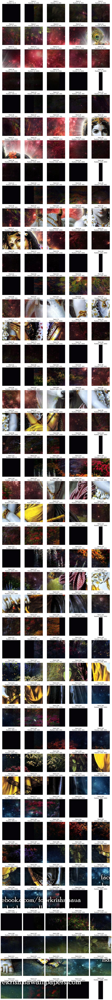

In [ ]:
import matplotlib.pyplot as plt

# Function to display patches as subplots
def display_patches(patches):
    num_patches = len(patches)
    num_cols = 5
    num_rows = (num_patches - 1) // num_cols + 1
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 3*num_rows))
    for i, (x, y, patch) in enumerate(patches):
        ax = axes[i // num_cols, i % num_cols]
        ax.imshow(patch)
        ax.set_title(f"Patch {i+1}\nPosition: ({x}, {y})")
        ax.axis("off")
    # Hide any empty subplots
    for i in range(num_patches, num_rows * num_cols):
        axes[i // num_cols, i % num_cols].axis("off")
    plt.tight_layout()
    plt.show()

# Display patches
display_patches(patches)

# **Getting Dataset**

In [ ]:
dataset, info = tfds.load('oxford_iiit_pet:3.*.*', with_info=True)

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/2 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/3680 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/oxford_iiit_pet/3.2.0.incompleteBV3N25/oxford_iiit_pet-train.tfrecord*...:…

Generating test examples...:   0%|          | 0/3669 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/oxford_iiit_pet/3.2.0.incompleteBV3N25/oxford_iiit_pet-test.tfrecord*...: …

Dataset oxford_iiit_pet downloaded and prepared to /root/tensorflow_datasets/oxford_iiit_pet/3.2.0. Subsequent calls will reuse this data.


# **Loading Dataset**

In [ ]:
def load_image(datapoint):
  input_image = tf.image.resize(datapoint['image'], (128, 128))
  input_mask = tf.image.resize(
    datapoint['segmentation_mask'],
    (128, 128),
    method = tf.image.ResizeMethod.NEAREST_NEIGHBOR,
  )

  input_image, input_mask = normalize(input_image, input_mask)

  return input_image, input_mask

# **Normalizing Dataset**

**Batch Normalization (BN):**
* Introduced by Sergey Ioffe and Christian Szegedy in 2015.
* Normalizes the inputs of each layer in a neural network.
* Ensures that the mean output activation is zero, and the standard deviation is one.
* Helps combat issues like internal covariate shift during training.
* Applied before the activation function in a network layer.
* Benefits include improved optimization, regularization, and the ability to train deeper networks.

**Layer Normalization (LN):**
* Normalizes across the height and width dimensions of each feature map separately.
* Calculates mean and variance for each individual sample across all channels and spatial dimensions.
* Useful for small or variable batch sizes.
* Applied before or after the activation function.

**Instance Normalization (IN):**
* Normalizes each individual channel for each individual sample across both spatial dimensions.
* Removes instance-specific contrast information from content images.
* Simplifies generation tasks like image stylization.

**Group Normalization (GN):**
* Divides channels into groups and normalizes features within each group.
* Independent of batch sizes.
* Useful when dealing with small or variable batches.
* Similar to IN when the group size is 1.

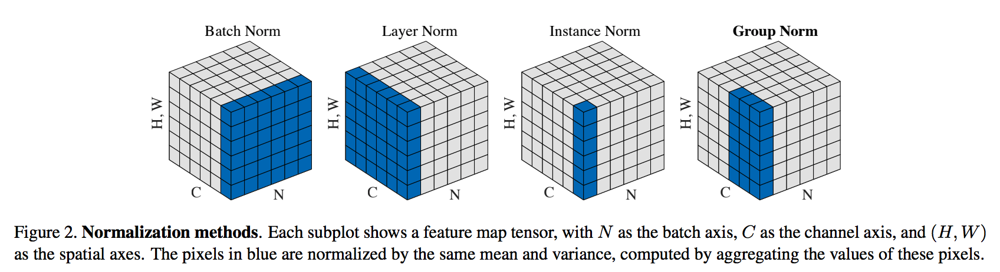

In [ ]:
def normalize(input_image, input_mask):
  input_image = tf.cast(input_image, tf.float32) / 255.0
  input_mask -= 1
  return input_image, input_mask

# **Making Train and Test sets**

In [ ]:
TRAIN_LENGTH = info.splits['train'].num_examples
BATCH_SIZE = 64
BUFFER_SIZE = 1000
STEPS_PER_EPOCH = TRAIN_LENGTH // BATCH_SIZE

In [ ]:
train_images = dataset['train'].map(load_image, num_parallel_calls=tf.data.AUTOTUNE)
test_images = dataset['test'].map(load_image, num_parallel_calls=tf.data.AUTOTUNE)

# **Augumenting Images**

* **Geometric Transformations:** Rotate, shear, zoom, crop, and flip images.
* **Color Space Transformations:** Adjust brightness, contrast, and color channels.
* **Kernel Filters:** Apply filters for blurring or sharpening.
* **Random Erasing:** Delete parts of the image.


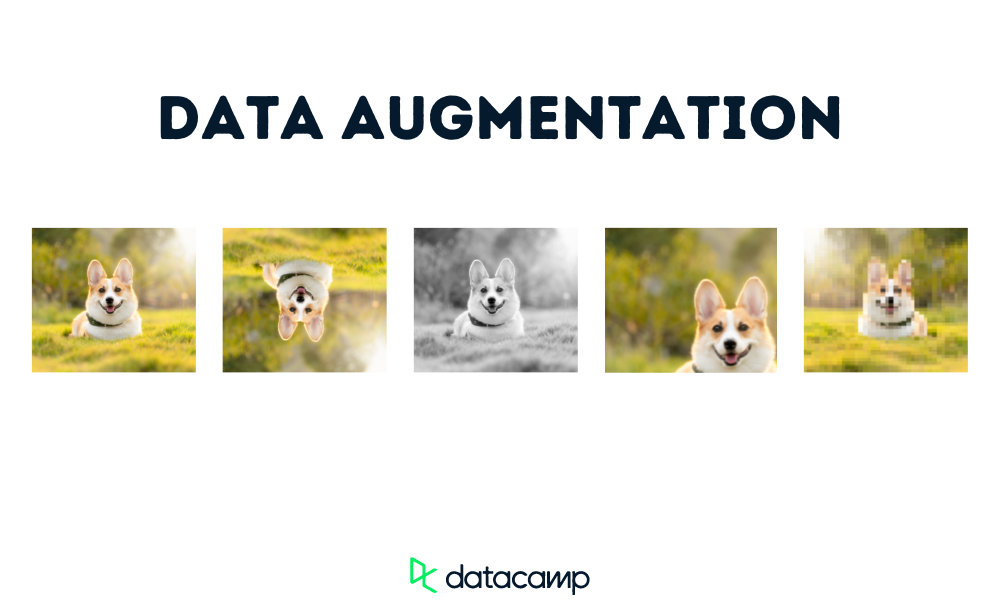

In [ ]:
class Augment(tf.keras.layers.Layer):
  def __init__(self, seed=42):
    super().__init__()
    # both use the same seed, so they'll make the same random changes.
    self.augment_inputs = tf.keras.layers.RandomFlip(mode="horizontal", seed=seed)
    self.augment_labels = tf.keras.layers.RandomFlip(mode="horizontal", seed=seed)

  def call(self, inputs, labels):
    inputs = self.augment_inputs(inputs)
    labels = self.augment_labels(labels)
    return inputs, labels

In [ ]:
train_batches = (
    train_images
    .cache()
    .shuffle(BUFFER_SIZE)
    .batch(BATCH_SIZE)
    .repeat()
    .map(Augment())
    .prefetch(buffer_size=tf.data.AUTOTUNE))

test_batches = test_images.batch(BATCH_SIZE)

# **Display Function**

In [ ]:
def display(display_list):
  plt.figure(figsize=(15, 15))

  title = ['Input Image', 'True Mask', 'Predicted Mask']

  for i in range(len(display_list)):
    plt.subplot(1, len(display_list), i+1)
    plt.title(title[i])
    plt.imshow(tf.keras.utils.array_to_img(display_list[i]))
    plt.axis('off')
  plt.show()

# **Model before finetuning**

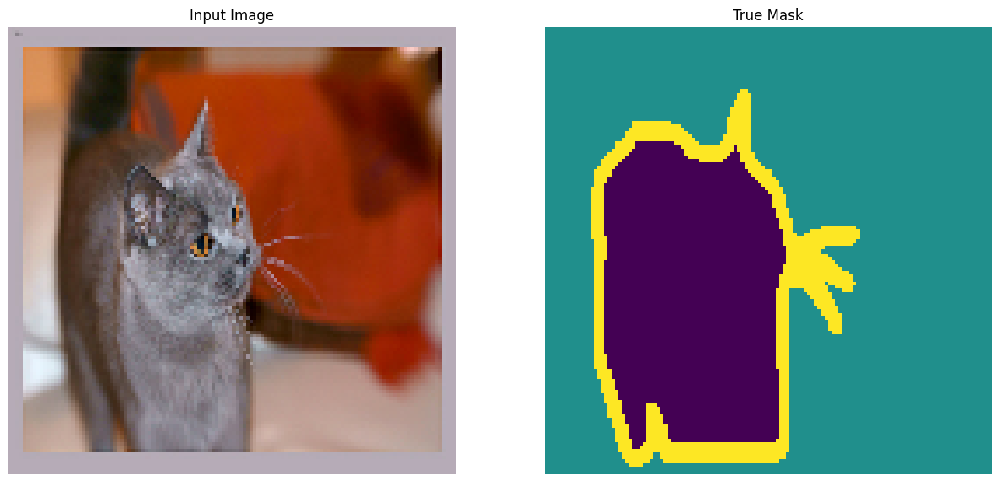

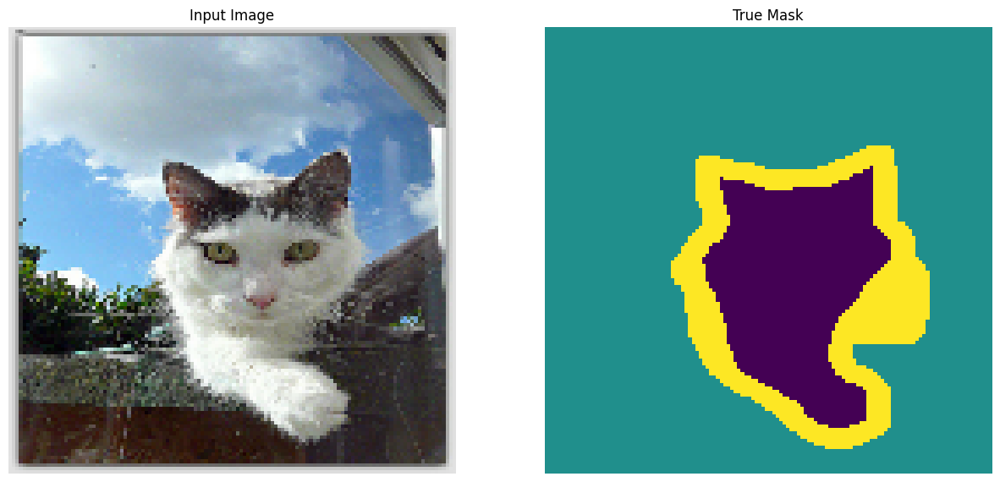

In [ ]:
for images, masks in train_batches.take(2):
  sample_image, sample_mask = images[0], masks[0]
  display([sample_image, sample_mask])

# **Defining Model Architecture**

* **Input Embeddings:** Convert input tokens into dense vectors, capturing semantic information.
* **Positional Encoding:** Inject positional information into the input embeddings to maintain sequence order.
* **Self-Attention Mechanism:** Computes attention scores between all positions of a sequence, emphasizing relevant tokens.
* **Multi-Head Attention:** Parallel attention mechanisms operating on different subspaces of input embeddings, facilitating richer representations.
* **Scaled Dot-Product Attention:** Attention mechanism scaling the dot products by square root of the dimensionality, ensuring stable gradients.
* **Query, Key, and Value:** Linear transformations applied to input embeddings to obtain queries, keys, and values for attention computation.
* **Feedforward Neural Network:** Applies two linear transformations with a non-linear activation function in between, enabling richer feature transformations.
* **Residual Connection:** Identity mapping to the output of a sub-layer, facilitating deeper networks without vanishing gradients.
* **Layer Normalization:** Normalizes activations across features, stabilizing learning and improving generalization.
* **Encoder Layer:** Consists of self-attention mechanism, feedforward neural network, and layer normalization, encoding input sequence.
* **Decoder Layer: **Incorporates self-attention mechanism, encoder-decoder attention mechanism, and feedforward neural network, decoding input sequence.
* **Encoder:** Stacks multiple encoder layers to process input sequences hierarchically, capturing contextual information.
* **Decoder:**  Stacks multiple decoder layers to generate output sequences based on encoded representations, facilitating sequence-to-sequence tasks.
* **Encoder-Decoder Attention:** Mechanism allowing decoder to attend to relevant parts of the input sequence during decoding.
* **Transformer Architecture:** Utilizes self-attention mechanisms and feedforward neural networks in encoder-decoder framework, enabling effective sequence modeling and generation.

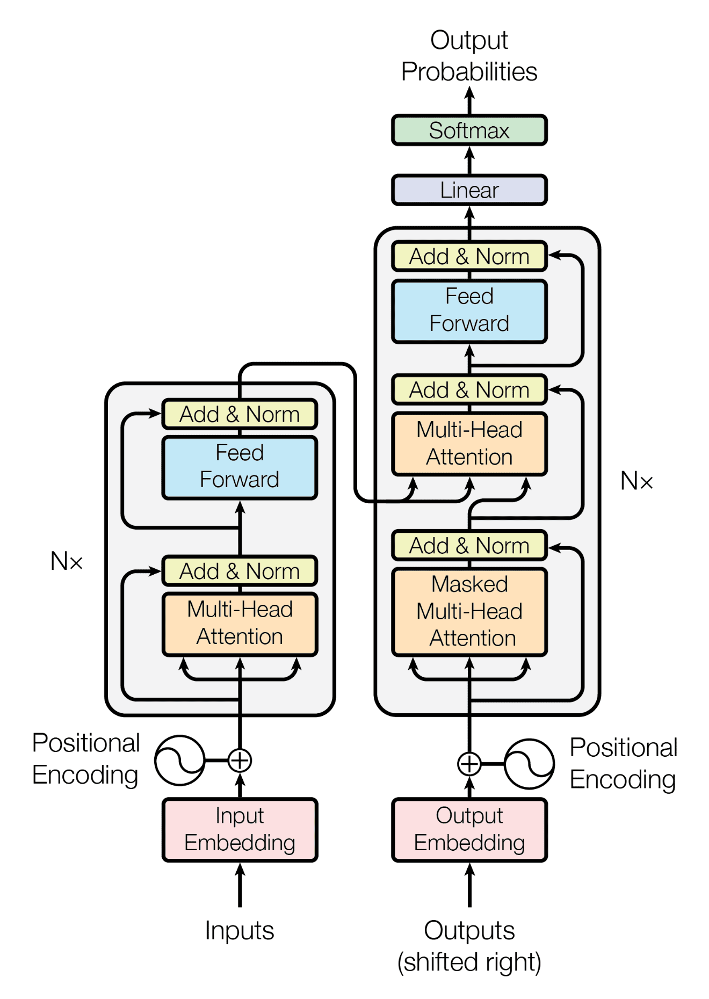

**Upsampling:**
* Upsampling is a process in digital signal processing or image processing where the resolution or size of a signal or an image is increased.
* In the context of image processing, it involves increasing the dimensions of an image, typically by interpolation, to obtain a higher resolution version.

**Downsampling:**
* Downsampling, conversely, is the process of reducing the resolution or size of a signal or an image.
* In image processing, it involves decreasing the dimensions of an image, often by decimation, to obtain a lower resolution version.

**Transfer Learning:**
* Transfer learning is a machine learning technique where a model trained on one task or dataset is reused or adapted as the starting point for a second related task or dataset. Instead of training a model from scratch on the new task, transfer learning leverages the knowledge learned by the pre-trained model on the original task.
* The key idea behind transfer learning is that features learned by a model on a large, general dataset may be applicable to other tasks or datasets, especially if they share similar underlying patterns or structures. By fine-tuning the pre-trained model on the new task or dataset, it can quickly adapt to the specific characteristics of the new data, potentially requiring less training data and computation compared to training from scratch.
* Transfer learning is particularly useful in scenarios where labeled training data for the target task is limited or expensive to obtain. It has been successfully applied across various domains, including computer vision, natural language processing, and speech recognition, among others.

**Fine-tuning:**
* Fine-tuning refers to the process of further training a pre-trained machine learning model on a new dataset, typically smaller and related to the original dataset.
* It involves initializing the model with weights learned from the pre-training stage and then updating these weights using the new dataset.
* Fine-tuning allows the model to adapt to the specific characteristics of the new dataset, potentially improving its performance on tasks related to the new data while leveraging the knowledge learned from the original dataset.
* Fine-tuning is commonly used in transfer learning scenarios where pre-trained models are adapted to specific tasks or domains.

In [ ]:
base_model = tf.keras.applications.MobileNetV2(input_shape=[128, 128, 3], include_top=False)

# Use the activations of these layers
layer_names = [
    'block_1_expand_relu',   # 64x64
    'block_3_expand_relu',   # 32x32
    'block_6_expand_relu',   # 16x16
    'block_13_expand_relu',  # 8x8
    'block_16_project',      # 4x4
]
base_model_outputs = [base_model.get_layer(name).output for name in layer_names]

# Create the feature extraction model
down_stack = tf.keras.Model(inputs=base_model.input, outputs=base_model_outputs)

down_stack.trainable = False

9406464/9406464 [==============================] - 0s 0us/step


In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import LayerNormalization, Concatenate, Conv2DTranspose

# Custom upsampling layer using Transformer and Conv2DTranspose
class TransformerUpsample(tf.keras.layers.Layer):
    def __init__(self, d_model, num_heads, dff, target_vocab_size, maximum_position_encoding, rate=0.1):
        super(TransformerUpsample, self).__init__()

        self.mha = tf.keras.layers.MultiHeadAttention(num_heads=num_heads, key_dim=d_model)
        self.conv1 = tf.keras.layers.Conv2DTranspose(d_model, 3, strides=2, padding='same')
        self.conv2 = tf.keras.layers.Conv2D(target_vocab_size, 3, padding='same')
        self.layernorm1 = LayerNormalization(epsilon=1e-6)
        self.layernorm2 = LayerNormalization(epsilon=1e-6)
        self.dropout1 = tf.keras.layers.Dropout(rate)
        self.dropout2 = tf.keras.layers.Dropout(rate)

    def call(self, inputs, training=True):
        attn_output = self.mha(inputs, inputs)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(inputs + attn_output)
        out2 = self.conv1(out1)
        out2 = self.dropout2(out2, training=training)
        out3 = self.conv2(out2)
        return out3

# Modify up_stack to use TransformerUpsample
up_stack = [
    TransformerUpsample(d_model=512, num_heads=8, dff=2048, target_vocab_size=64, maximum_position_encoding=64),  # 4x4 -> 8x8
    TransformerUpsample(d_model=256, num_heads=8, dff=1024, target_vocab_size=64, maximum_position_encoding=64),  # 8x8 -> 16x16
    TransformerUpsample(d_model=128, num_heads=8, dff=512, target_vocab_size=64, maximum_position_encoding=64),  # 16x16 -> 32x32
    TransformerUpsample(d_model=64, num_heads=8, dff=256, target_vocab_size=64, maximum_position_encoding=64),  # 32x32 -> 64x64
]

def unet_model(output_channels: int):
    inputs = tf.keras.layers.Input(shape=[128, 128, 3])

    # Downsampling through the model
    skips = down_stack(inputs)
    x = skips[-1]
    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x, training=True)  # Note the addition of the 'training=True' argument
        concat = Concatenate()
        x = concat([x, skip])

    # This is the last layer of the model
    last = Conv2DTranspose(
        filters=output_channels, kernel_size=3, strides=2, padding='same')  #64x64 -> 128x128

    x = last(x)

    return tf.keras.Model(inputs=inputs, outputs=x)

# Create U-Net model
output_channels = 3  # Assuming RGB images
model = unet_model(output_channels)

In [ ]:
OUTPUT_CLASSES = 3

model = unet_model(output_channels=OUTPUT_CLASSES)
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

# **Visualising Model**

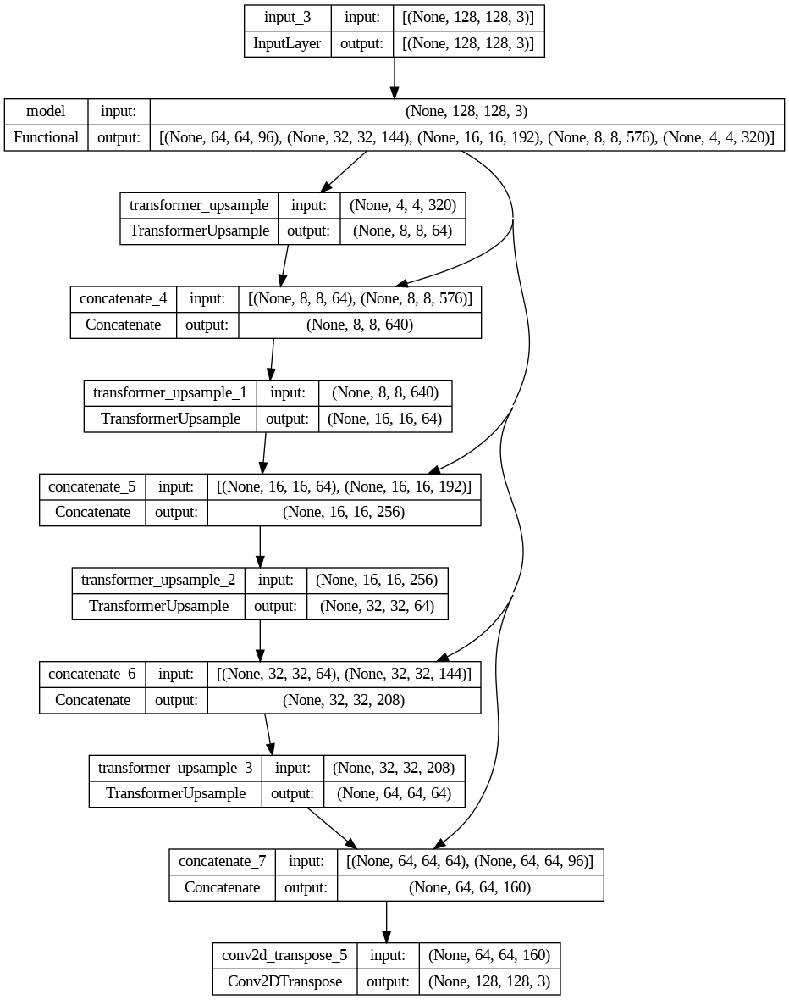

In [ ]:
tf.keras.utils.plot_model(model, show_shapes=True)

In [ ]:
model.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 model (Functional)          [(None, 64, 64, 96),         1841984   ['input_3[0][0]']             
                              (None, 32, 32, 144),                                                
                              (None, 16, 16, 192),                                                
                              (None, 8, 8, 576),                                                  
                              (None, 4, 4, 320)]                                                  
                                                                                            

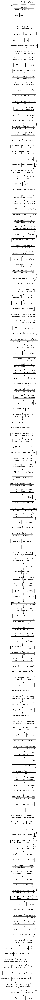

In [ ]:
# Save the model graph for visualization in TensorBoard
tf.keras.utils.plot_model(model, to_file='3D_model.png', show_shapes=True, expand_nested=True)

# **Creating Mask Function and Showing Predictions**

In [ ]:
def create_mask(pred_mask):
  pred_mask = tf.math.argmax(pred_mask, axis=-1)
  pred_mask = pred_mask[..., tf.newaxis]
  return pred_mask[0]

In [ ]:
def show_predictions(dataset=None, num=1):
  if dataset:
    for image, mask in dataset.take(num):
      pred_mask = model.predict(image)
      display([image[0], mask[0], create_mask(pred_mask)])
  else:
    display([sample_image, sample_mask,
             create_mask(model.predict(sample_image[tf.newaxis, ...]))])

1/1 [==============================] - 9s 9s/step


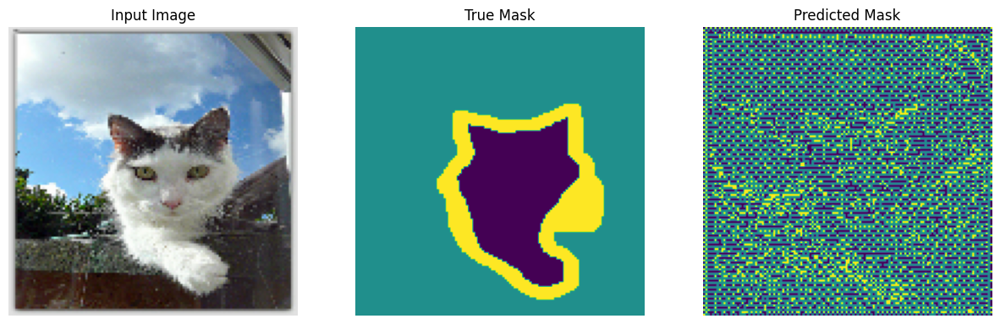

In [ ]:
show_predictions()

In [ ]:
class DisplayCallback(tf.keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs=None):
    clear_output(wait=True)
    show_predictions()
    print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

2/2 [==============================] - 2s 22ms/step


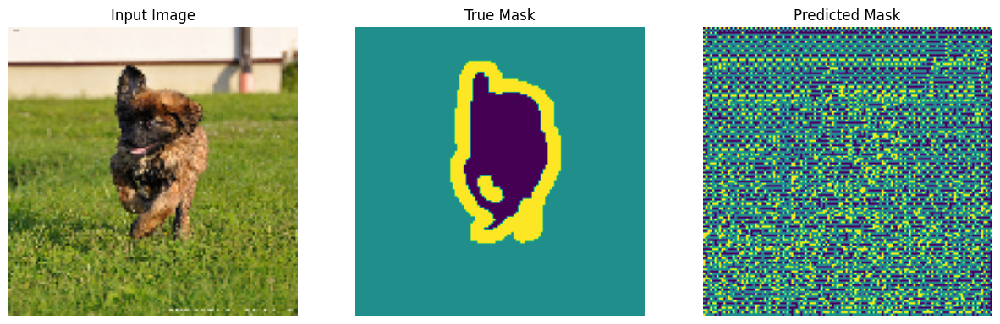

2/2 [==============================] - 0s 147ms/step


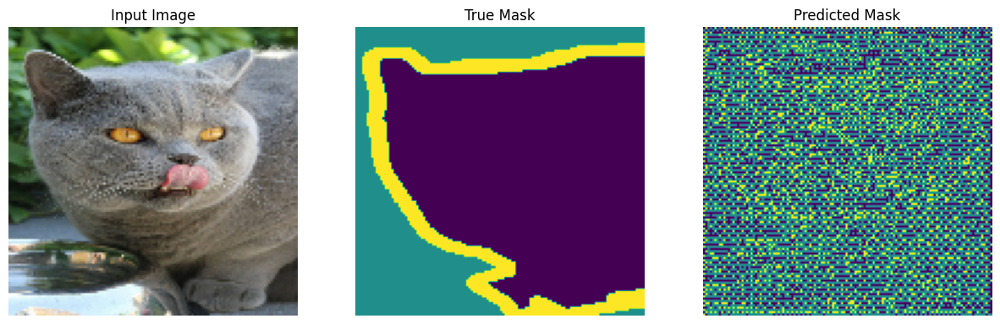

2/2 [==============================] - 0s 147ms/step


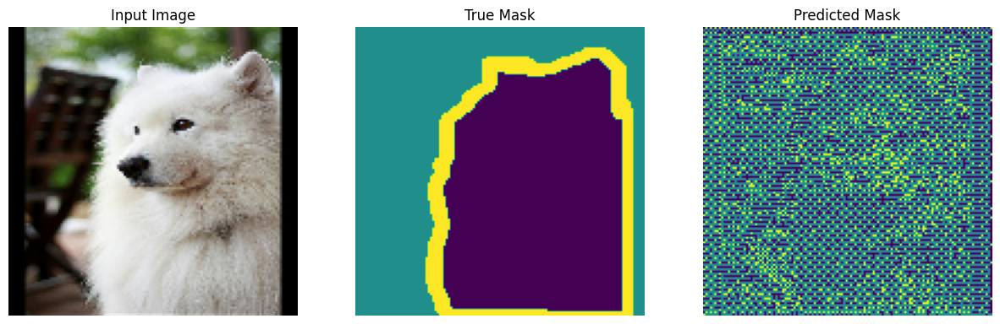

In [ ]:
show_predictions(test_batches, 3)

# **Training Model**

After 20 epochs the following was observed:

57/57 [==============================] - 47s 833ms/step - loss: 0.1830 - accuracy: 0.9257 - val_loss: 0.2594 - val_accuracy: 0.9064

1/1 [==============================] - 0s 23ms/step


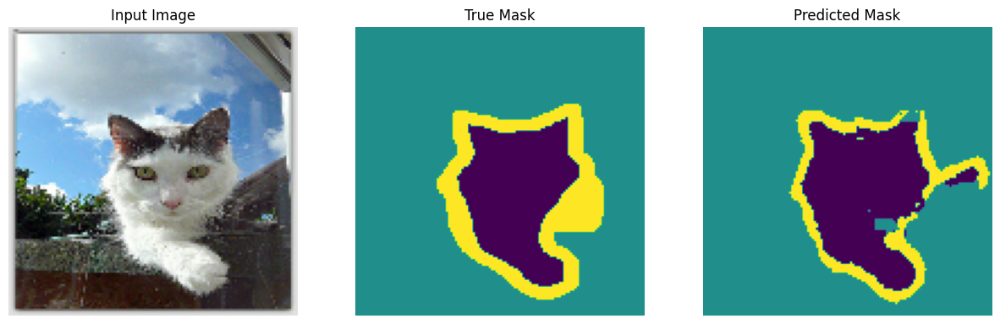


Sample Prediction after epoch 20

57/57 [==============================] - 47s 825ms/step - loss: 0.2466 - accuracy: 0.9030 - val_loss: 0.2933 - val_accuracy: 0.8900


In [ ]:
EPOCHS = 20
VAL_SUBSPLITS = 5
VALIDATION_STEPS = info.splits['test'].num_examples//BATCH_SIZE//VAL_SUBSPLITS

model_history = model.fit(train_batches, epochs=EPOCHS,
                          steps_per_epoch=STEPS_PER_EPOCH,
                          validation_steps=VALIDATION_STEPS,
                          validation_data=test_batches,
                          callbacks=[DisplayCallback()])

# **Visualising Loss**

<ipython-input-30-b18e663a5288>:5: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r" (-> color=(1.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  plt.plot(model_history.epoch, loss, 'r', label='Training loss',color="red")
<ipython-input-30-b18e663a5288>:6: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r" (-> color=(1.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  plt.plot(model_history.epoch, val_loss, 'r', label='Validation loss',color="green")


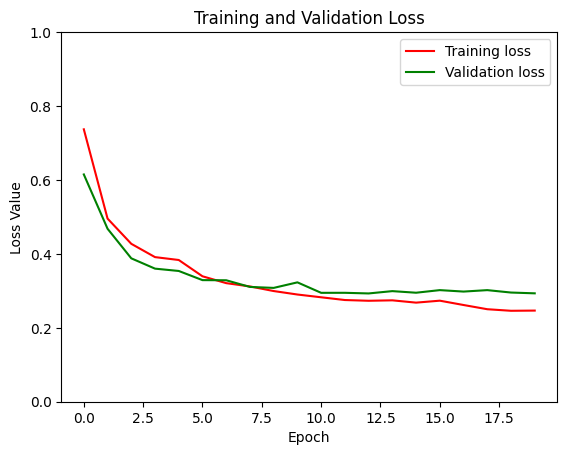

In [ ]:
loss = model_history.history['loss']
val_loss = model_history.history['val_loss']

plt.figure()
plt.plot(model_history.epoch, loss, 'r', label='Training loss',color="red")
plt.plot(model_history.epoch, val_loss, 'r', label='Validation loss',color="green")
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss Value')
plt.ylim([0, 1])
plt.legend()
plt.show()

# **Calculating IoU Score**

**IoU Score**
* **Intersection over Union (IoU)** also known as the Jaccard index, is a metric used in computer vision to evaluate the performance of object detection algorithms.
* It quantifies the degree of overlap between two bounding boxes: one representing the “ground truth” (actual location of an object) and the other representing the model’s “prediction” for the same object.

**Calculation**
* **Intersection Area:** Calculate the area of overlap between the predicted bounding box and the ground truth bounding box.
* **Union Area:** Calculate the total area covered by both bounding boxes (sum of their individual areas).

**IoU Score:**
* Divide the intersection area by the union area.
* IoU =
 (Intersection Area) / (Union Area)

**Interpretation:**
* IoU ranges from 0 to 1.
* A higher IoU indicates better alignment between the predicted and ground truth bounding boxes.
* For example, if the IoU is 1, the predicted box perfectly overlaps with the ground truth box. If the IoU is 0, there is no overlap.

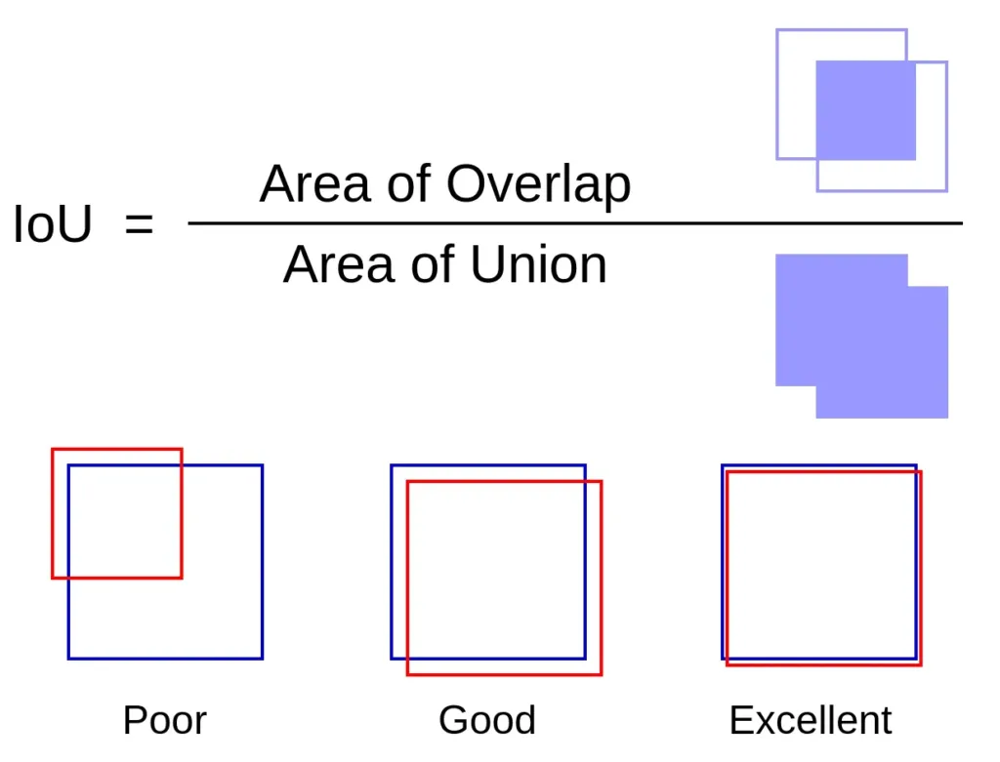

In [ ]:
def create_mask_c(pred_mask):
  pred_mask = tf.math.argmax(pred_mask, axis=-1)
  pred_mask = pred_mask[..., tf.newaxis]
  return pred_mask[0]

In [ ]:
import numpy as np

def calculate_iou(y_true, y_pred):
    # Flatten the masks
    y_true_flatten = tf.reshape(y_true, [-1])
    y_pred_flatten = tf.reshape(y_pred, [-1])

    # Calculate intersection and union
    intersection = tf.reduce_sum(y_true_flatten * y_pred_flatten)
    union = tf.reduce_sum(y_true_flatten) + tf.reduce_sum(y_pred_flatten) - intersection

    # Calculate IoU
    iou = intersection / (union)  # Adding a small epsilon to avoid division by zero

    return iou

iou_scores = []

for images, masks in test_batches:
    pred_masks = model.predict(images)
    for true_mask, pred_mask in zip(masks, pred_masks):
        true_mask = create_mask_c(true_mask)
        pred_mask = create_mask_c(pred_mask)
        iou = calculate_iou(true_mask, pred_mask)
        iou_scores.append(iou.numpy())

mean_iou = np.mean(iou_scores)
print("Mean IoU score for test samples:", mean_iou)

1/1 [==============================] - 0s 39ms/step
Mean IoU score for test samples: 0.0
